<div>

> **Note**
>
> Code chunks run Python commands unless it starts with `%%bash`, in
> which case, those chunks run shell commands.

</div>

Adapted from tutorials by Giovanni Palla
(https://scanpy-tutorials.readthedocs.io/en/latest/spatial/integration-scanorama.html)
and Carlos Talavera-López
(https://docs.scvi-tools.org/en/latest/tutorials/notebooks/stereoscope_heart_LV_tutorial.html)

Spatial transcriptomic data with the Visium platform is in many ways
similar to scRNAseq data. It contains UMI counts for 5-20 cells instead
of single cells, but is still quite sparse in the same way as scRNAseq
data is, but with the additional information about spatial location in
the tissue.\
Here we will first run quality control in a similar manner to scRNAseq
data, then QC filtering, dimensionality reduction, integration and
clustering. Then we will use scRNAseq data from mouse cortex to run
label transfer to predict celltypes in the Visium spots.\
We will use two **Visium** spatial transcriptomics dataset of the mouse
brain (Sagittal), which are publicly available from the [10x genomics
website](https://support.10xgenomics.com/spatial-gene-expression/datasets/).
Note, that these dataset have already been filtered for spots that does
not overlap with the tissue.

## Preparation

Load packages

In [1]:
import scanpy as sc
import anndata as an
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scanorama
import warnings
import os

warnings.simplefilter(action="ignore", category=Warning)

sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

Load ST data

The function `datasets.visium_sge()` downloads the dataset from 10x
genomics and returns an AnnData object that contains counts, images and
spatial coordinates. We will calculate standards QC metrics with
`pp.calculate_qc_metrics()` and visualize them.

When using your own Visium data, use Scanpy's read_visium() function to
import it.

In [2]:
# download pre-computed data if missing or long compute
fetch_data = True

# url for source and intermediate data
path_data = "https://export.uppmax.uu.se/naiss2023-23-3/workshops/workshop-scrnaseq"

if not os.path.exists("./data/spatial/visium"):
    os.makedirs("./data/spatial/visium")

In [3]:
adata_anterior = sc.datasets.visium_sge(
    sample_id="V1_Mouse_Brain_Sagittal_Anterior"
)
adata_posterior = sc.datasets.visium_sge(
    sample_id="V1_Mouse_Brain_Sagittal_Posterior"
)

reading /home/jovyan/workdir/scanpy/data/V1_Mouse_Brain_Sagittal_Anterior/filtered_feature_bc_matrix.h5
 (0:00:00)
reading /home/jovyan/workdir/scanpy/data/V1_Mouse_Brain_Sagittal_Posterior/filtered_feature_bc_matrix.h5
 (0:00:00)


In [4]:
adata_anterior.var_names_make_unique()
adata_posterior.var_names_make_unique()

To make sure that both images are included in the merged object, use
uns_merge="unique".

In [5]:
# merge into one dataset
library_names = ["V1_Mouse_Brain_Sagittal_Anterior", "V1_Mouse_Brain_Sagittal_Posterior"]

adata = adata_anterior.concatenate(
    adata_posterior,
    batch_key="library_id",
    uns_merge="unique",
    batch_categories=library_names
)

adata

AnnData object with n_obs × n_vars = 6050 × 32285
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

As you can see, we now have the slot spatial in obsm, which contains the
spatial information from the Visium platform.

## Quality control

Similar to scRNA-seq we use statistics on number of counts, number of
features and percent mitochondria for quality control.

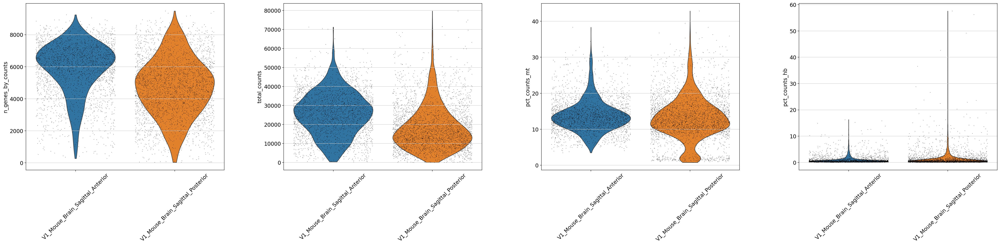

In [6]:
# add info on mitochondrial and hemoglobin genes to the objects.
adata.var['mt'] = adata.var_names.str.startswith('mt-') 
adata.var['hb'] = adata.var_names.str.contains(("^Hb.*-"))

sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','hb'], percent_top=None, log1p=False, inplace=True)

sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_hb'], jitter=0.4, groupby = 'library_id', rotation= 45)

We can also plot the same data onto the tissue section.

In scanpy, this is a bit tricky when you have multiple sections, as you
would have to subset and plot them separately.

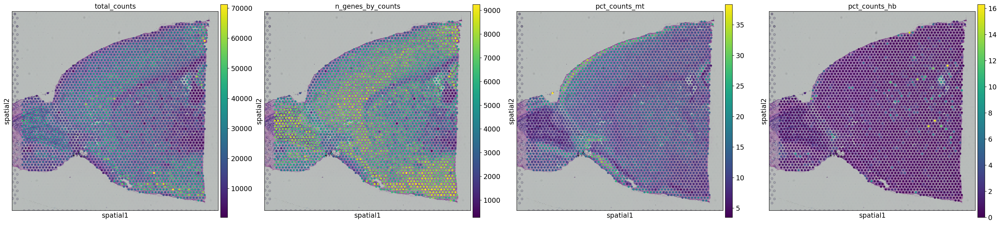

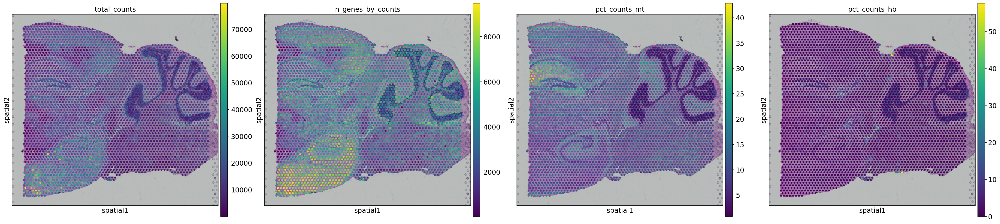

In [7]:
# need to plot the two sections separately and specify the library_id
for library in library_names:
    sc.pl.spatial(adata[adata.obs.library_id == library,:], library_id=library, color = ["total_counts", "n_genes_by_counts",'pct_counts_mt', 'pct_counts_hb'])

As you can see, the spots with low number of counts/features and high
mitochondrial content are mainly towards the edges of the tissue. It is
quite likely that these regions are damaged tissue. You may also see
regions within a tissue with low quality if you have tears or folds in
your section.\
But remember, for some tissue types, the amount of genes expressed and
proportion mitochondria may also be a biological features, so bear in
mind what tissue you are working on and what these features mean.

### Filter spots

Select all spots with less than **25%** mitocondrial reads, less than
**20%** hb-reads and **500** detected genes. You must judge for yourself
based on your knowledge of the tissue what are appropriate filtering
criteria for your dataset.

In [8]:
keep = (adata.obs['pct_counts_hb'] < 20) & (adata.obs['pct_counts_mt'] < 25) & (adata.obs['n_genes_by_counts'] > 1000)
print(sum(keep))

adata = adata[keep,:]

5749


And replot onto tissue sections.

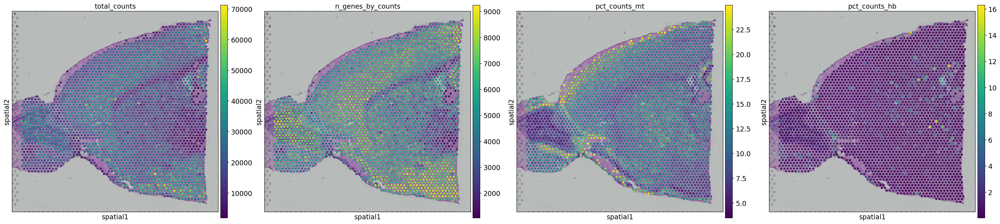

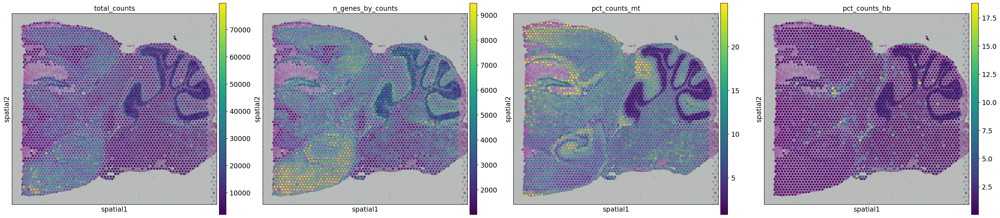

In [9]:
for library in library_names:
    sc.pl.spatial(adata[adata.obs.library_id == library,:], library_id=library, color = ["total_counts", "n_genes_by_counts",'pct_counts_mt', 'pct_counts_hb'])

### Top expressed genes

As for scRNA-seq data, we will look at what the top expressed genes are.

normalizing counts per cell
    finished (0:00:00)


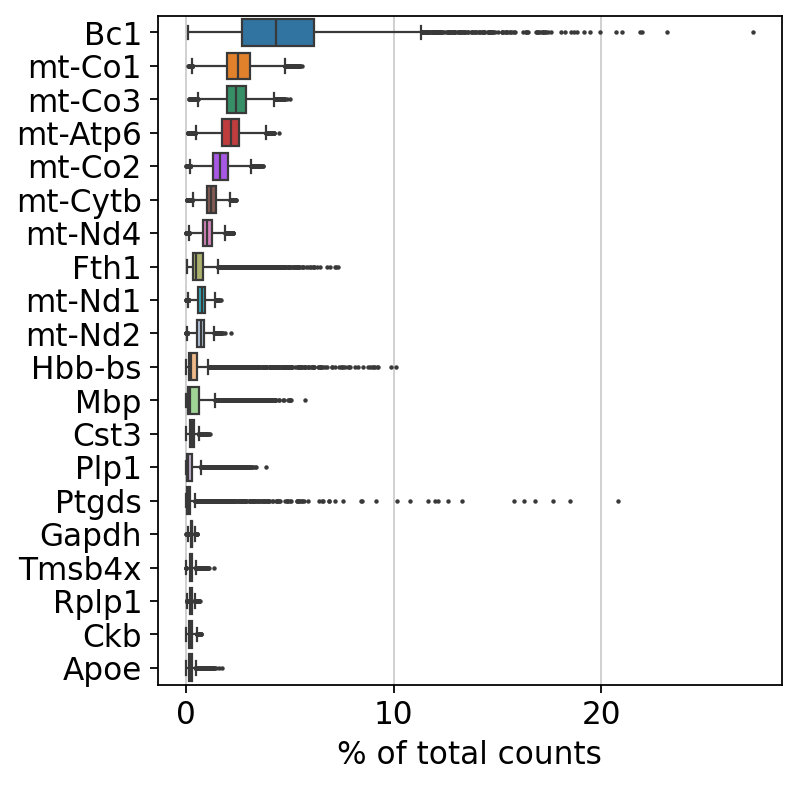

In [10]:
sc.pl.highest_expr_genes(adata, n_top=20)

As you can see, the mitochondrial genes are among the top expressed
genes. Also the lncRNA gene Bc1 (brain cytoplasmic RNA 1). Also one
hemoglobin gene.

### Filter genes

We will remove the *Bc1* gene, hemoglobin genes (blood contamination)
and the mitochondrial genes.

In [11]:
mito_genes = adata.var_names.str.startswith('mt-')
hb_genes = adata.var_names.str.contains('^Hb.*-')

remove = np.add(mito_genes, hb_genes)
remove[adata.var_names == "Bc1"] = True
keep = np.invert(remove)
print(sum(remove))

adata = adata[:,keep]

print(adata.n_obs, adata.n_vars)

22
5749 32263


## Analysis

We will proceed with the data in a very similar manner to scRNA-seq
data.

As we have two sections, we will select variable genes with
batch_key="library_id" and then take the union of variable genes for
further analysis. The idea is to avoid including batch specific genes in
the analysis.

In [12]:
# save the counts to a separate object for later, we need the normalized counts in raw for DEG dete
counts_adata = adata.copy()

sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
# take 1500 variable genes per batch and then use the union of them.
sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=1500, inplace=True, batch_key="library_id")

# subset for variable genes
adata.raw = adata
adata = adata[:,adata.var.highly_variable_nbatches > 0]

# scale data
sc.pp.scale(adata)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


Now we can plot gene expression of individual genes, the gene *Hpca* is
a strong hippocampal marker and *Ttr* is a marker of the choroid plexus.

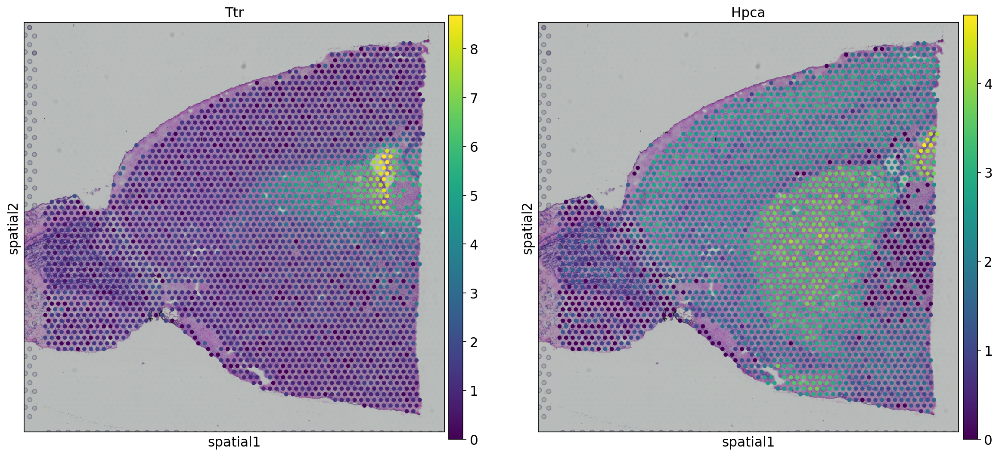

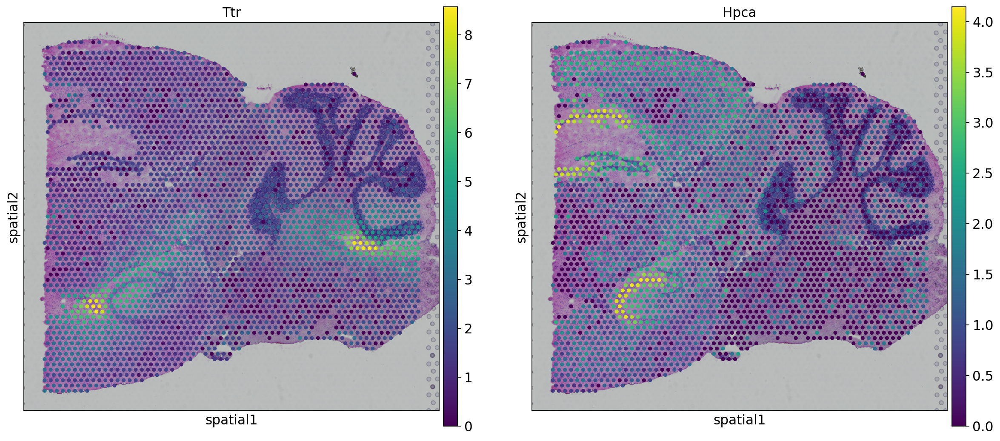

In [13]:
for library in library_names:
    sc.pl.spatial(adata[adata.obs.library_id == library,:], library_id=library, color = ["Ttr", "Hpca"])

### Dimensionality reduction and clustering

We can then now run dimensionality reduction and clustering using the
same workflow as we use for scRNA-seq analysis.

In [14]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters")

computing neighbors
computing PCA
    with n_comps=50
    finished (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:07)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:09)
running Leiden clustering
    finished: found 20 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


We can then plot clusters onto umap or onto the tissue section.

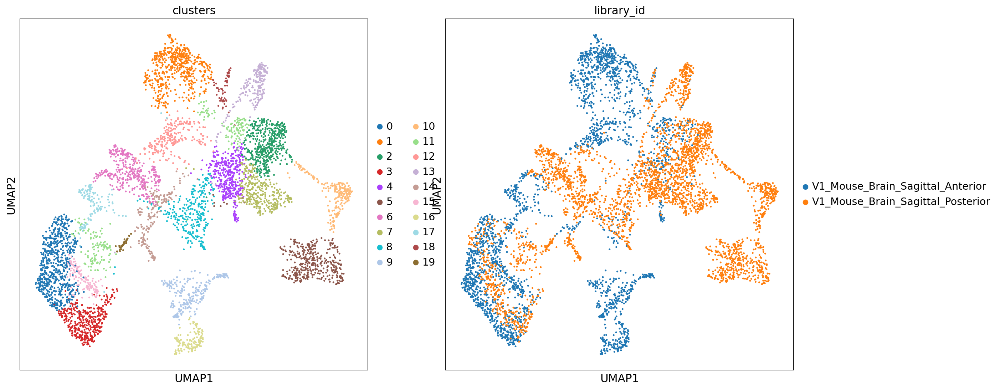

In [15]:
sc.pl.umap(
    adata, color=["clusters", "library_id"], palette=sc.pl.palettes.default_20
)

As we are plotting the two sections separately, we need to make sure
that they get the same colors by fetching cluster colors from a dict.

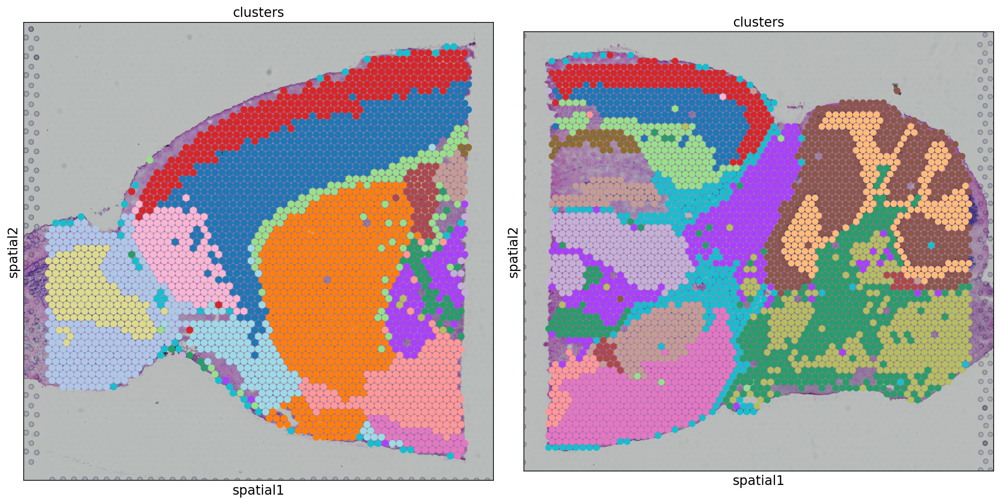

In [16]:
clusters_colors = dict(
    zip([str(i) for i in range(len(adata.obs.clusters.cat.categories))], adata.uns["clusters_colors"])
)

fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ["V1_Mouse_Brain_Sagittal_Anterior", "V1_Mouse_Brain_Sagittal_Posterior"]
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color="clusters",
        size=1.5,
        palette=[
            v
            for k, v in clusters_colors.items()
            if k in ad.obs.clusters.unique().tolist()
        ],
        legend_loc=None,
        show=False,
        ax=axs[i],
    )

plt.tight_layout()

### Integration

Quite often, there are strong batch effects between different ST
sections, so it may be a good idea to integrate the data across
sections.

We will do a similar integration as in the Data Integration lab, here we
will use Scanorama for integration.

In [17]:
adatas = {}
for batch in library_names:
    adatas[batch] = adata[adata.obs['library_id'] == batch,]

adatas 

{'V1_Mouse_Brain_Sagittal_Anterior': View of AnnData object with n_obs × n_vars = 2597 × 2405
     obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_hb', 'pct_counts_hb', 'clusters'
     var: 'gene_ids', 'feature_types', 'genome', 'mt', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
     uns: 'spatial', 'library_id_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters', 'clusters_colors'
     obsm: 'spatial', 'X_pca', 'X_umap'
     varm: 'PCs'
     obsp: 'distances', 'connectivities',
 'V1_Mouse_Brain_Sagittal_Posterior': View of AnnData object with n_obs × n_vars = 3152 × 2405
     obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 't

In [18]:
import scanorama

#convert to list of AnnData objects
adatas = list(adatas.values())

# run scanorama.integrate
scanorama.integrate_scanpy(adatas, dimred = 50)

# Get all the integrated matrices.
scanorama_int = [ad.obsm['X_scanorama'] for ad in adatas]

# make into one matrix.
all_s = np.concatenate(scanorama_int)
print(all_s.shape)

# add to the AnnData object
adata.obsm["Scanorama"] = all_s

adata

Found 2405 genes among all datasets
[[0.         0.47824413]
 [0.         0.        ]]
Processing datasets (0, 1)
(5749, 50)


AnnData object with n_obs × n_vars = 5749 × 2405
    obs: 'in_tissue', 'array_row', 'array_col', 'library_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_hb', 'pct_counts_hb', 'clusters'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mean', 'std'
    uns: 'spatial', 'library_id_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters', 'clusters_colors'
    obsm: 'spatial', 'X_pca', 'X_umap', 'Scanorama'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

Then we run dimensionality reduction and clustering as before.

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:08)
running Leiden clustering
    finished: found 19 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


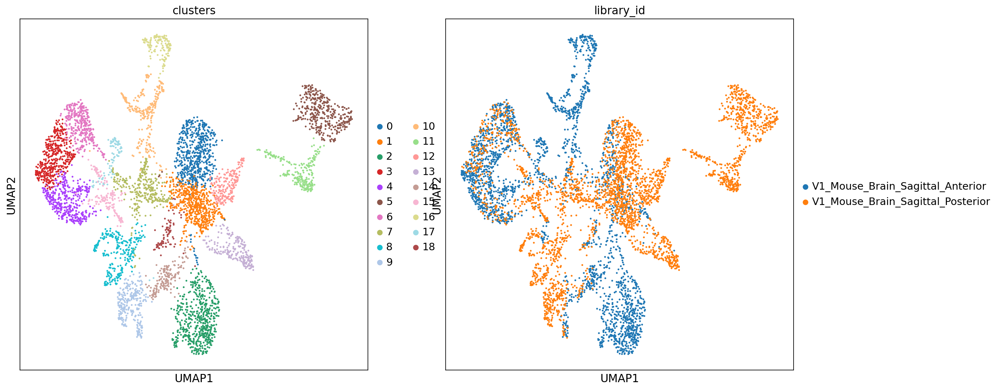

In [19]:
sc.pp.neighbors(adata, use_rep="Scanorama")
sc.tl.umap(adata)
sc.tl.leiden(adata, key_added="clusters")

sc.pl.umap(
    adata, color=["clusters", "library_id"], palette=sc.pl.palettes.default_20
)

As we have new clusters, we again need to make a new dict for cluster
colors

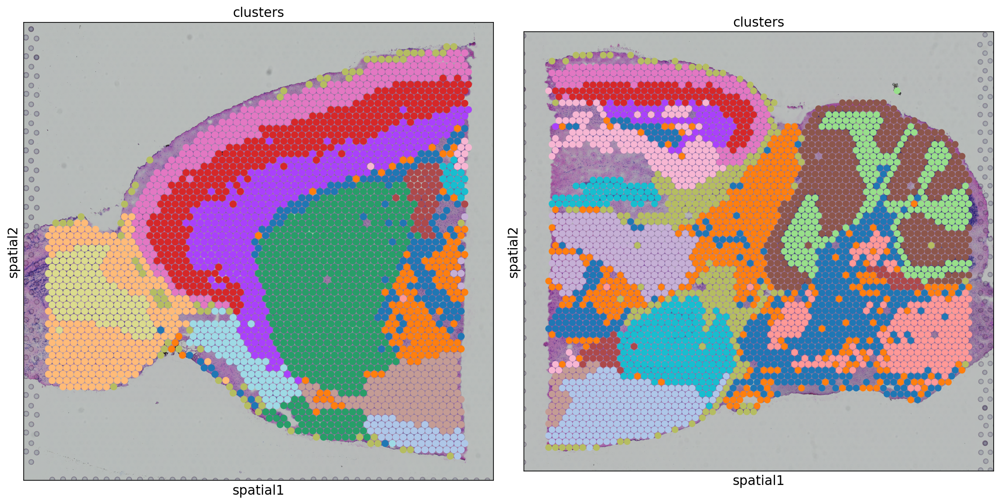

In [20]:
clusters_colors = dict(
    zip([str(i) for i in range(len(adata.obs.clusters.cat.categories))], adata.uns["clusters_colors"])
)

fig, axs = plt.subplots(1, 2, figsize=(15, 10))

for i, library in enumerate(
    ["V1_Mouse_Brain_Sagittal_Anterior", "V1_Mouse_Brain_Sagittal_Posterior"]
):
    ad = adata[adata.obs.library_id == library, :].copy()
    sc.pl.spatial(
        ad,
        img_key="hires",
        library_id=library,
        color="clusters",
        size=1.5,
        palette=[
            v
            for k, v in clusters_colors.items()
            if k in ad.obs.clusters.unique().tolist()
        ],
        legend_loc=None,
        show=False,
        ax=axs[i],
    )

plt.tight_layout()

<div>

> **Discuss**
>
> Do you see any differences between the integrated and non-integrated
> clustering? Judge for yourself, which of the clusterings do you think
> looks best? As a reference, you can compare to brain regions in the
> [Allen brain
> atlas](https://mouse.brain-map.org/experiment/thumbnails/100042147?image_type=atlas).

</div>

### Spatially Variable Features

There are two main workflows to identify molecular features that
correlate with spatial location within a tissue. The first is to perform
differential expression based on spatially distinct clusters, the other
is to find features that have spatial patterning without taking clusters
or spatial annotation into account. First, we will do differential
expression between clusters just as we did for the scRNAseq data before.

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:16)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters']`
categories: 0, 1, 2, etc.
var_group_labels: 5


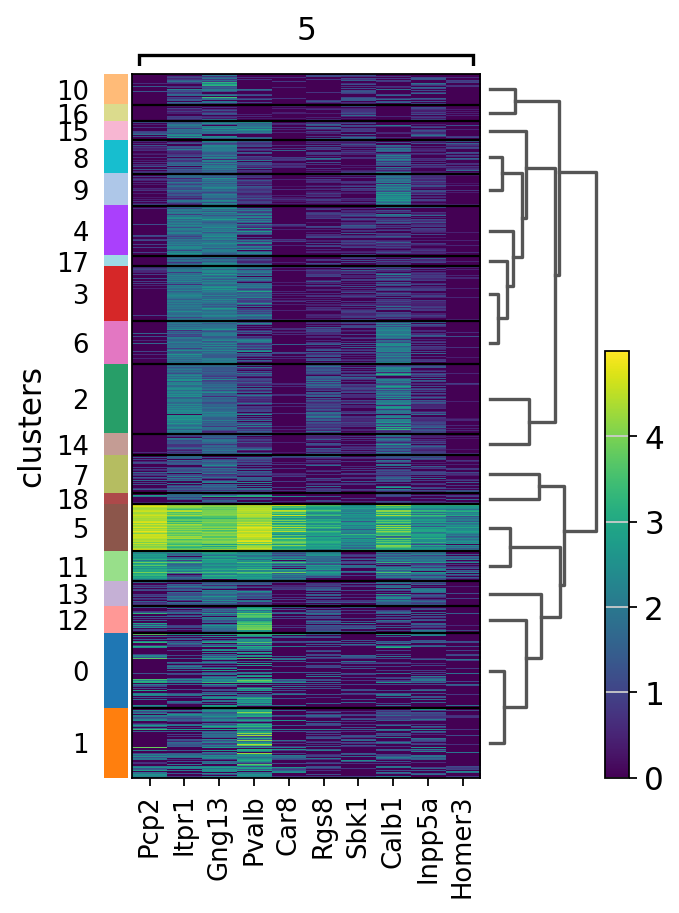

In [21]:
# run t-test 
sc.tl.rank_genes_groups(adata, "clusters", method="wilcoxon")
# plot as heatmap for cluster5 genes
sc.pl.rank_genes_groups_heatmap(adata, groups="5", n_genes=10, groupby="clusters")

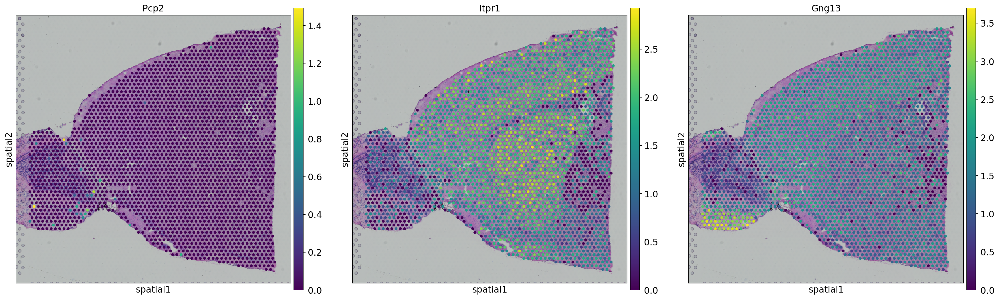

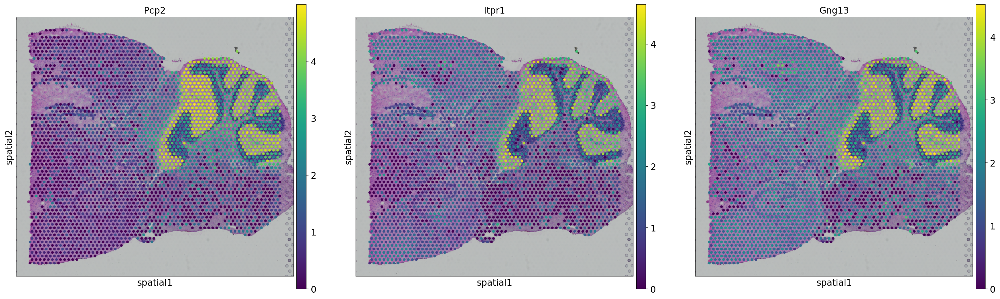

In [22]:
# plot onto spatial location
top_genes = sc.get.rank_genes_groups_df(adata, group='5',log2fc_min=0)['names'][:3]

for library in ["V1_Mouse_Brain_Sagittal_Anterior", "V1_Mouse_Brain_Sagittal_Posterior"]:
    sc.pl.spatial(adata[adata.obs.library_id == library,:], library_id=library, color = top_genes)

Spatial transcriptomics allows researchers to investigate how gene
expression trends varies in space, thus identifying spatial patterns of
gene expression. For this purpose there are multiple methods, such as
SpatailDE, SPARK, Trendsceek, HMRF and Splotch.

We use SpatialDE Svensson et al., a Gaussian process-based statistical
framework that aims to identify spatially variable genes.

<div>

> **Caution**
>
> This is a slow compute intensive step, we will not run this now and
> instead use a pre-computed file in the step below.
>
> ``` {python}
> # | results: hide
> # this code is not executed
>
> if not fetch_data:
>     import NaiveDE
>     import SpatialDE
>
>     counts = sc.get.obs_df(adata, keys=list(adata.var_names), use_raw=True)
>     total_counts = sc.get.obs_df(adata, keys=["total_counts"])
>     norm_expr = NaiveDE.stabilize(counts.T).T
>     resid_expr = NaiveDE.regress_out(
>         total_counts, norm_expr.T, "np.log(total_counts)").T
>     results = SpatialDE.run(adata.obsm["spatial"], resid_expr)
>
>     import pickle
>     with open('data/spatial/visium/scanpy_spatialde.pkl', 'wb') as file:
>         pickle.dump(results, file)
> ```

</div>

Download precomputed file.

In [23]:
path_file = "data/spatial/visium/scanpy_spatialde.pkl"
if fetch_data and not os.path.exists(path_file):
    import urllib.request
    file_url = os.path.join(
        path_data, "spatial/visium/results/scanpy_spatialde.pkl")
    urllib.request.urlretrieve(file_url, path_file)

In [24]:
import pickle
with open('data/spatial/visium/scanpy_spatialde.pkl', 'rb') as file:
    results = pickle.load(file)

In [25]:
#| eval: false
# skip for now.

# We concatenate the results with the DataFrame of annotations of variables: `adata.var`.
results.index = results["g"]
adata.var = pd.concat(
    [adata.var, results.loc[adata.var.index.values, :]], axis=1)
adata.write_h5ad('./data/spatial/visium/adata_processed_sc.h5ad')

# Then we can inspect significant genes that varies in space and visualize them with `sc.pl.spatial` function.
results.sort_values("qval").head(10)

,FSV,M,g,l,max_delta,max_ll,max_mu_hat,max_s2_t_hat,model,n,s2_FSV,s2_logdelta,time,BIC,max_ll_null,LLR,pval,qval
g,,,,,,,,,,,,,,,,,,
Pcp2,0.311857,4,Pcp2,1143.629056,1.942926,-5951.142118,2.926354,0.250801,SE,5749,0.000151,0.003614,0.004486,11936.911361,-6660.401054,709.258937,0.0,0.0
Arpp21,0.111727,4,Arpp21,544.733658,7.705871,-4564.518758,-5.508770,0.234582,SE,5749,0.000009,0.000811,0.004505,9163.664641,-4883.168776,318.650018,0.0,0.0
Fam107b,0.142934,4,Fam107b,544.733658,5.811807,-3153.361188,-0.138821,0.029021,SE,5749,0.000011,0.000676,0.004312,6341.349500,-3593.498319,440.137132,0.0,0.0
Ccdc3,0.089396,4,Ccdc3,544.733658,9.872922,-1973.573273,-1.011429,0.017939,SE,5749,0.000011,0.001366,0.004875,3981.773670,-2119.287504,145.714232,0.0,0.0
Spink8,0.386160,4,Spink8,544.733658,1.540709,-89.582212,-1.292471,0.048386,SE,5749,0.000023,0.000463,0.004225,213.791549,-878.843599,789.261387,0.0,0.0
Vim,0.152102,4,Vim,544.733658,5.403095,-5073.752713,0.314954,0.061191,SE,5749,0.000023,0.001294,0.004482,10182.132550,-5309.926117,236.173404,0.0,0.0
Cdhr4,0.058661,4,Cdhr4,544.733658,15.553480,5174.380569,-0.720568,0.003751,SE,5749,0.000007,0.001779,0.004288,-10314.134013,5055.927174,118.453395,0.0,0.0
Camkv,0.148880,4,Camkv,544.733658,5.540997,-4285.018227,-5.748463,0.267292,SE,5749,0.000011,0.000640,0.004441,8604.663579,-4661.390989,376.372762,0.0,0.0
Pip4k2a,0.057655,4,Pip4k2a,544.733658,15.841994,-4829.402616,0.638928,0.021795,SE,5749,0.000005,0.001414,0.004472,9693.432357,-4950.743568,121.340952,0.0,0.0


## Single cell data

We can use a scRNA-seq dataset as a reference to predict the proportion
of different celltypes in the Visium spots. Keep in mind that it is
important to have a reference that contains all the celltypes you expect
to find in your spots. Ideally it should be a scRNA-seq reference from
the exact same tissue. We will use a reference scRNA-seq dataset of
\~14,000 adult mouse cortical cell taxonomy from the Allen Institute,
generated with the SMART-Seq2 protocol.

Conveniently, you can also download the pre-processed dataset in h5ad
format.

In [26]:
import urllib.request
import os

path_file = "data/spatial/visium/allen_cortex.h5ad"
if not os.path.exists(path_file):
    file_url = os.path.join(
        path_data, "spatial/visium/allen_cortex.h5ad")
    urllib.request.urlretrieve(file_url, path_file)

In [27]:
adata_cortex = sc.read_h5ad("data/spatial/visium/allen_cortex.h5ad")
adata_cortex

AnnData object with n_obs × n_vars = 14249 × 34617
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample_id', 'sample_type', 'organism', 'donor', 'sex', 'age_days', 'eye_condition', 'genotype', 'driver_lines', 'reporter_lines', 'brain_hemisphere', 'brain_region', 'brain_subregion', 'injection_label_direction', 'injection_primary', 'injection_secondary', 'injection_tract', 'injection_material', 'injection_exclusion_criterion', 'facs_date', 'facs_container', 'facs_sort_criteria', 'rna_amplification_set', 'library_prep_set', 'library_prep_avg_size_bp', 'seq_name', 'seq_tube', 'seq_batch', 'total_reads', 'percent_exon_reads', 'percent_intron_reads', 'percent_intergenic_reads', 'percent_rrna_reads', 'percent_mt_exon_reads', 'percent_reads_unique', 'percent_synth_reads', 'percent_ecoli_reads', 'percent_aligned_reads_total', 'complexity_cg', 'genes_detected_cpm_criterion', 'genes_detected_fpkm_criterion', 'tdt_cpm', 'gfp_cpm', 'class', 'subclass', 'cluster', 'confusion_score', 'cluster

Here is the metadata for the cell annotation:

In [28]:
adata_cortex.obs

,orig.ident,nCount_RNA,nFeature_RNA,sample_id,sample_type,organism,donor,sex,age_days,eye_condition,...,genes_detected_cpm_criterion,genes_detected_fpkm_criterion,tdt_cpm,gfp_cpm,class,subclass,cluster,confusion_score,cluster_correlation,core_intermediate_call
F1S4_160108_001_A01,0,1730700.0,9029,527128530,Cells,Mus musculus,225675,M,53,Normal,...,10445,9222,248.86,248.86,GABAergic,Vip,Vip Arhgap36 Hmcn1,0.4385,0.837229,Intermediate
F1S4_160108_001_B01,0,1909605.0,10207,527128536,Cells,Mus musculus,225675,M,53,Normal,...,11600,10370,289.61,289.61,GABAergic,Lamp5,Lamp5 Lsp1,0.1025,0.878743,Core
F1S4_160108_001_C01,0,1984948.0,10578,527128542,Cells,Mus musculus,225675,M,53,Normal,...,11848,10734,281.06,281.06,GABAergic,Lamp5,Lamp5 Lsp1,0.0195,0.887084,Core
F1S4_160108_001_D01,0,2291552.0,8482,527128548,Cells,Mus musculus,225675,M,53,Normal,...,9494,8561,390.02,390.02,GABAergic,Vip,Vip Crispld2 Htr2c,0.2734,0.843552,Core
F1S4_160108_001_E01,0,1757463.0,8697,527128554,Cells,Mus musculus,225675,M,53,Normal,...,10012,8791,253.92,253.92,GABAergic,Lamp5,Lamp5 Plch2 Dock5,0.7532,0.854994,Core
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
FYS4_171004_104_C01,2,949356.0,9141,645142562,Cells,Mus musculus,350650,M,51,Normal,...,9629,9229,432.15,432.15,Glutamatergic,L5 PT,L5 PT VISp C1ql2 Cdh13,0.0477,0.885255,Core
FYS4_171004_104_D01,2,998736.0,6927,645142573,Cells,Mus musculus,350650,M,51,Normal,...,7701,7023,217.83,217.83,GABAergic,Sst,Sst Hpse Sema3c,0.1064,0.854499,Core
FYS4_171004_104_F01,2,1002766.0,6936,645142613,Cells,Mus musculus,350650,M,51,Normal,...,7888,7054,91.88,91.88,Glutamatergic,L5 PT,L5 PT VISp Chrna6,0.0095,0.822625,Core
FYS4_171004_104_G01,2,1025804.0,8027,645142648,Cells,Mus musculus,350650,M,51,Normal,...,8933,8146,127.77,127.77,GABAergic,Sst,Sst Calb2 Pdlim5,0.2852,0.856322,Core


There is an issue with the raw matrix in this object that the gene names
are not in the index, so we will put them back in.

In [29]:
adata_cortex.raw.var.index = adata_cortex.raw.var._index
adata_cortex.raw.var

,_index
_index,
0610005C13Rik,0610005C13Rik
0610006L08Rik,0610006L08Rik
0610007P14Rik,0610007P14Rik
0610009B22Rik,0610009B22Rik
0610009E02Rik,0610009E02Rik
...,...
Zzef1,Zzef1
Zzz3,Zzz3
a,a


Then we run the regular pipline with normalization and dimensionality
reduction.

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:15)


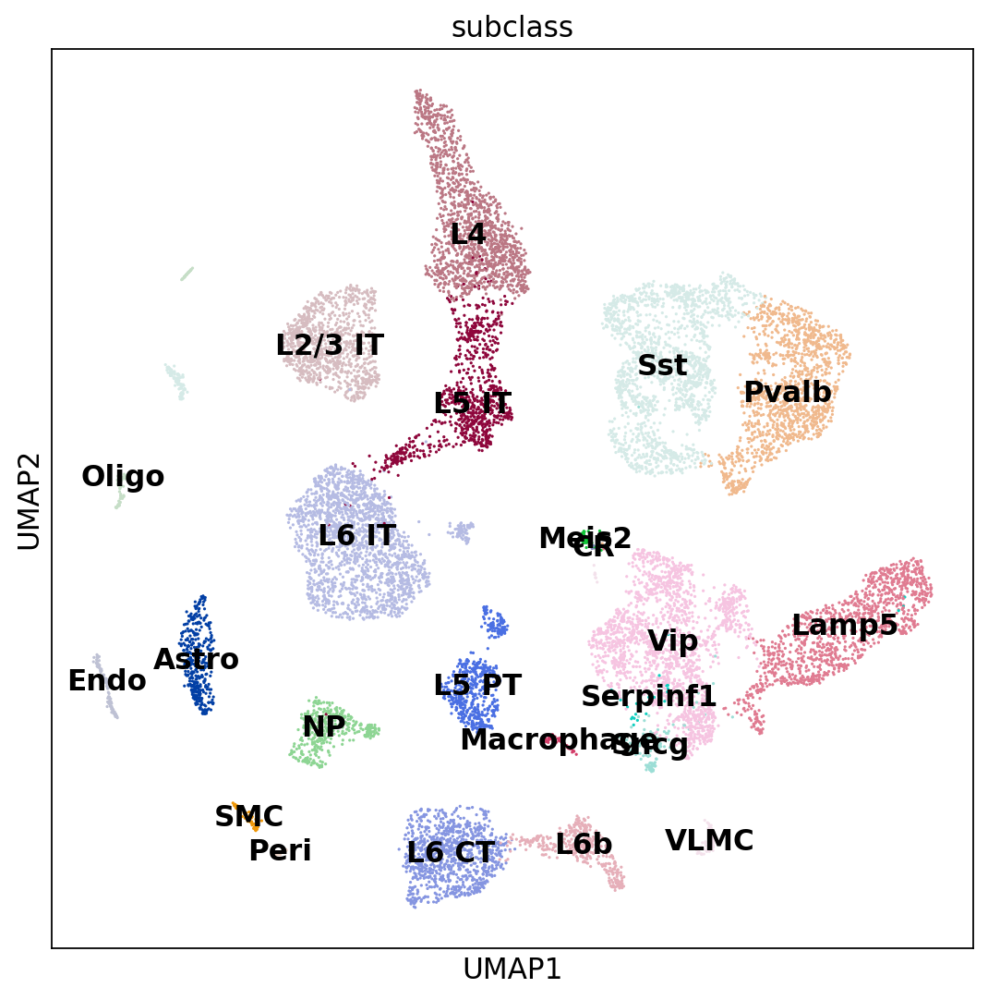

In [30]:
sc.pp.normalize_total(adata_cortex, target_sum=1e5)
sc.pp.log1p(adata_cortex)
sc.pp.highly_variable_genes(adata_cortex, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pp.scale(adata_cortex, max_value=10)
sc.tl.pca(adata_cortex, svd_solver='arpack')
sc.pp.neighbors(adata_cortex, n_pcs=30)
sc.tl.umap(adata_cortex)
sc.pl.umap(adata_cortex, color="subclass", legend_loc='on data')

In [31]:
adata_cortex.obs.subclass.value_counts()

L6 IT         1872
Sst           1741
Vip           1728
L4            1401
Pvalb         1337
Lamp5         1122
L2/3 IT        982
L6 CT          960
L5 IT          880
L5 PT          544
Astro          368
NP             362
L6b            358
Sncg           125
Endo            94
Oligo           91
VLMC            67
SMC             55
Macrophage      51
Meis2           45
Peri            32
Serpinf1        27
CR               7
Name: subclass, dtype: int64

For speed, and for a more fair comparison of the celltypes, we will
subsample all celltypes to a maximum of 200 cells per class
(`subclass`).

In [32]:
target_cells = 200

adatas2 = [adata_cortex[adata_cortex.obs.subclass == clust] for clust in adata_cortex.obs.subclass.cat.categories]

for dat in adatas2:
    if dat.n_obs > target_cells:
          sc.pp.subsample(dat, n_obs=target_cells)

adata_cortex = adatas2[0].concatenate(*adatas2[1:])

adata_cortex.obs.subclass.value_counts()

Astro         200
L6 IT         200
Sst           200
Pvalb         200
NP            200
Lamp5         200
L6b           200
Vip           200
L6 CT         200
L5 PT         200
L5 IT         200
L4            200
L2/3 IT       200
Sncg          125
Endo           94
Oligo          91
VLMC           67
SMC            55
Macrophage     51
Meis2          45
Peri           32
Serpinf1       27
CR              7
Name: subclass, dtype: int64

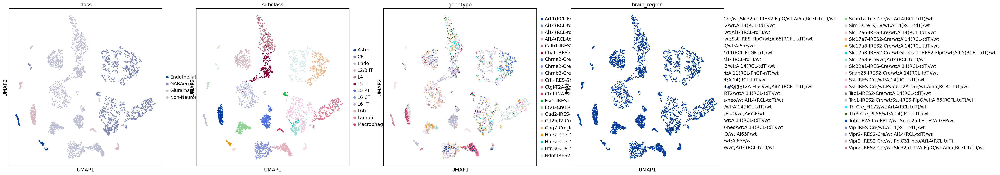

In [33]:
sc.pl.umap(
    adata_cortex, color=["class", "subclass", "genotype", "brain_region"], palette=sc.pl.palettes.default_28
)

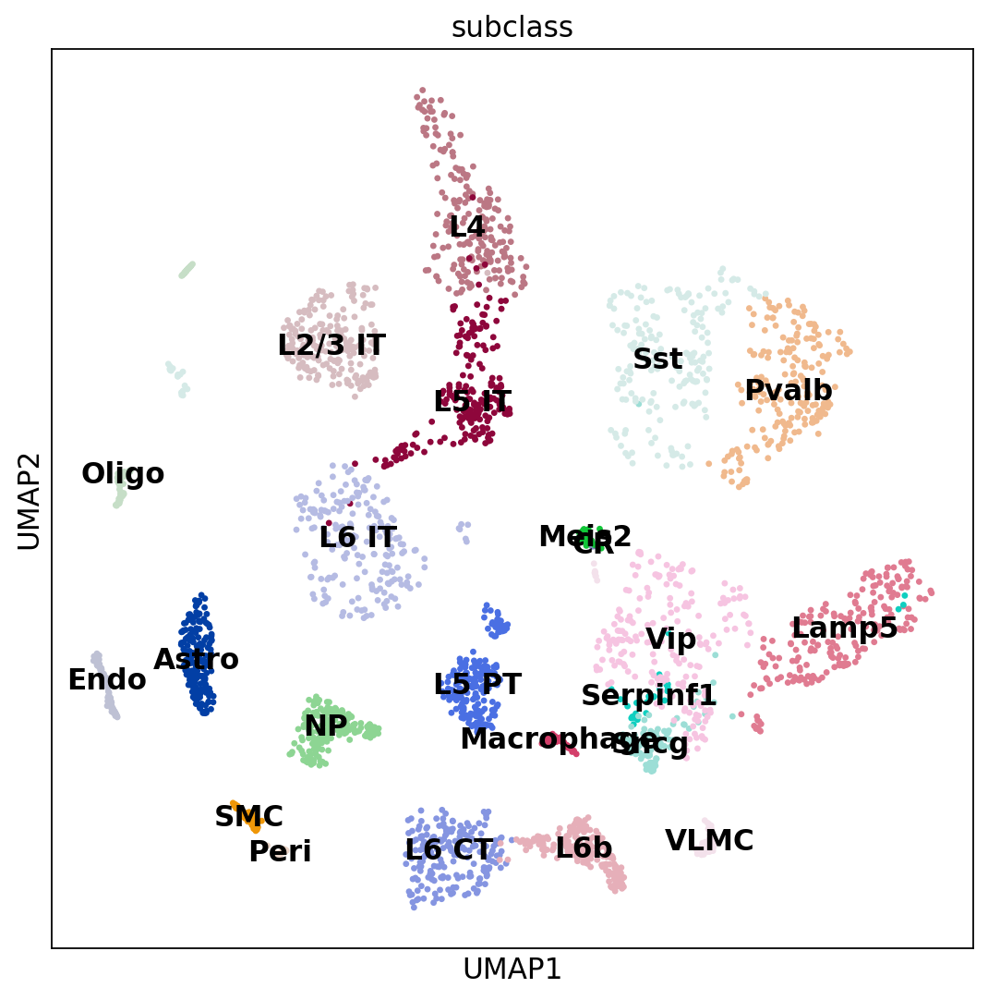

In [34]:
sc.pl.umap(adata_cortex, color="subclass", legend_loc = 'on data')

## Subset ST for cortex

Since the scRNAseq dataset was generated from the mouse cortex, we will
subset the visium dataset in order to select mainly the spots part of
the cortex. Note that the integration can also be performed on the whole
brain slice, but it would give rise to false positive cell type
assignments and therefore it should be interpreted with more care.

For deconvolution we will need the counts data, so we will subset from
the counts_adata object that we created earlier.

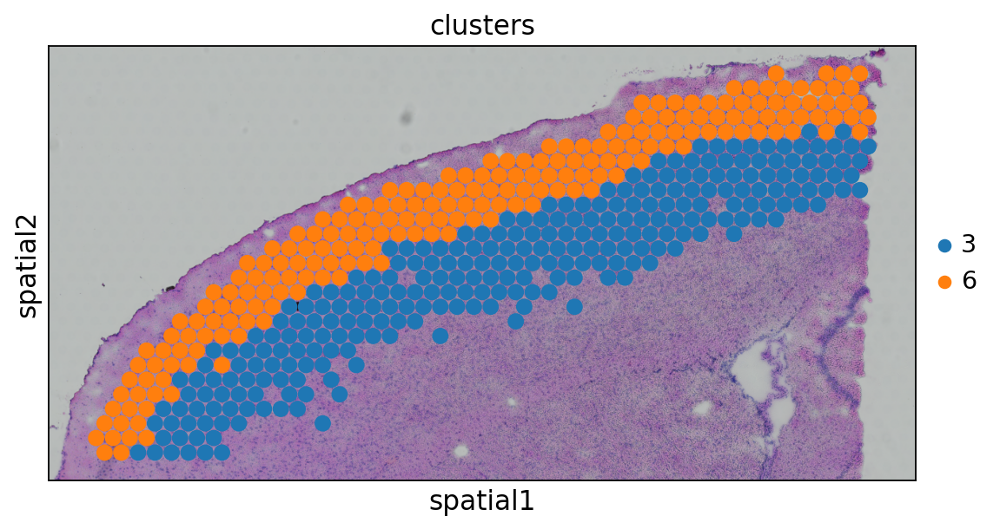

In [35]:
lib_a = "V1_Mouse_Brain_Sagittal_Anterior"

counts_adata.obs['clusters'] = adata.obs.clusters

adata_anterior_subset = counts_adata[
    (counts_adata.obs.library_id == lib_a) 
    & (counts_adata.obsm["spatial"][:, 1] < 6000), :
].copy()

# select also the cortex clusters
adata_anterior_subset = adata_anterior_subset[adata_anterior_subset.obs.clusters.isin(['3','5','6']),:]

# plot to check that we have the correct regions

sc.pl.spatial(
    adata_anterior_subset,
    img_key="hires",
    library_id = lib_a,
    color=['clusters'],
    size=1.5
)

## Deconvolution

Deconvolution is a method to estimate the abundance (or proportion) of
different celltypes in a bulkRNAseq dataset using a single cell
reference. As the Visium data can be seen as a small bulk, we can both
use methods for traditional bulkRNAseq as well as methods especially
developed for Visium data. Some methods for deconvolution are DWLS,
cell2location, Tangram, Stereoscope, RCTD, SCDC and many more.

Here, we will use deconvolution with Stereoscope implemented in the
SCVI-tools package. To read more about Stereoscope please check out this
github page (https://github.com/almaan/stereoscope)

### Select genes for deconvolution

Most deconvolution methods does a prior gene selection and there are
different options that are used: - Use variable genes in the SC data. -
Use variable genes in both SC and ST data - DE genes between clusters in
the SC data.\
In this case we will use top DE genes per cluster, so first we have to
run DGE detection on the scRNAseq data.

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_subclass']`


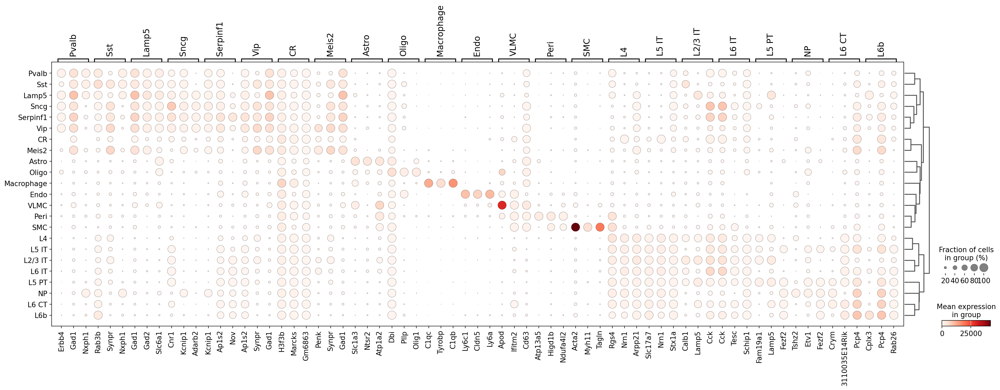

In [36]:
sc.tl.rank_genes_groups(adata_cortex, 'subclass', method = "t-test", n_genes=100, use_raw=False)
sc.pl.rank_genes_groups_dotplot(adata_cortex, n_genes=3)

In [37]:
sc.tl.filter_rank_genes_groups(adata_cortex, min_fold_change=1)

genes = sc.get.rank_genes_groups_df(adata_cortex, group = None)
genes

Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1, max_out_group_fraction: 0.5


,group,names,scores,logfoldchanges,pvals,pvals_adj
0,Astro,Slc1a3,160.842041,NaN,3.174856e-300,2.358455e-298
1,Astro,Ntsr2,150.887924,NaN,1.097071e-231,6.056987e-230
2,Astro,Atp1a2,138.091385,11.185134,0.000000e+00,0.000000e+00
3,Astro,Aldoc,131.687424,NaN,0.000000e+00,0.000000e+00
4,Astro,Apoe,124.696922,9.052421,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...
2295,Vip,Srrm4,18.501577,NaN,2.355896e-47,1.812313e-45
2296,Vip,Dlx1as,18.485483,NaN,7.043876e-47,5.347322e-45
2297,Vip,Aplp2,18.252756,NaN,1.859496e-52,1.671953e-50
2298,Vip,Rit2,18.057701,NaN,1.506046e-48,1.201263e-46


In [38]:
deg = genes.names.unique().tolist()
print(len(deg))
# check that the genes are also present in the ST data

deg = np.intersect1d(deg,adata_anterior_subset.var.index).tolist()
print(len(deg))

1388
1307


### Train the model

First, train the model using scRNAseq data.

Stereoscope requires the data to be in counts, earlier in this tutorial
we saved the spatial counts in a separate object counts_adata.

In the single cell data we have the raw counts in the `raw.X` matrix so
that one will be used. So here we create a new object with all the
correct slots for scVI.

In [39]:
sc_adata = adata_cortex.copy()
sc_adata.X = adata_cortex.raw.X.copy()

Setup the anndata, the implementation requires the counts matrix to be
in the "counts" layer as a copy.

In [40]:
import scvi
# from scvi.data import register_tensor_from_anndata
from scvi.external import RNAStereoscope, SpatialStereoscope

# add counts layer
sc_adata.layers["counts"] = sc_adata.X.copy()

# subset for the selected genes
sc_adata = sc_adata[:, deg].copy()

# create stereoscope object
RNAStereoscope.setup_anndata(sc_adata, layer="counts", labels_key="subclass")

In [41]:
# the model is saved to a file, so if is slow to run, you can simply reload it from disk by setting train = False

train = False
if train:
    sc_model = RNAStereoscope(sc_adata)
    sc_model.train(max_epochs=300)
    sc_model.history["elbo_train"][10:].plot()
    sc_model.save("./data/spatial/visium/scanpy_scmodel", overwrite=True)
else:
    sc_model = RNAStereoscope.load("./data/spatial/visium/scanpy_scmodel", sc_adata)
    print("Loaded RNA model from file!")

INFO     File ./data/spatial/visium/scanpy_scmodel/model.pt already downloaded                                     
Loaded RNA model from file!


### Predict proportions on the spatial data

First create a new st object with the correct genes and counts as a
layer.

In [42]:
st_adata = adata_anterior_subset.copy()

st_adata.layers["counts"] = st_adata.X.copy()
st_adata = st_adata[:, deg].copy()

SpatialStereoscope.setup_anndata(st_adata, layer="counts")

In [ ]:
train = True
if train:
    spatial_model = SpatialStereoscope.from_rna_model(st_adata, sc_model)
    spatial_model.train(max_epochs = 3000)
    spatial_model.history["elbo_train"][10:].plot()
    spatial_model.save("./data/spatial/visium/scanpy_stmodel", overwrite = True)
else:
    spatial_model = SpatialStereoscope.load("./data/spatial/visium/scanpy_stmodel", st_adata)
    print("Loaded Spatial model from file!")

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Epoch 2284/3000:  76%|███████▌  | 2283/3000 [12:09<04:41,  2.55it/s, v_num=1, train_loss_step=1.08e+6, train_loss_epoch=1.08e+6]

Get the results from the model, also put them in the .obs slot.

In [ ]:
st_adata.obsm["deconvolution"] = spatial_model.get_proportions()

# also copy to the obsm data frame
for ct in st_adata.obsm["deconvolution"].columns:
    st_adata.obs[ct] = st_adata.obsm["deconvolution"][ct]

We are then able to explore how cell types in the scRNA-seq dataset are
predicted onto the visium dataset. Let's first visualize the neurons
cortical layers.

In [ ]:
sc.pl.spatial(
    st_adata,
    img_key="hires",
    color=["L2/3 IT", "L4", "L5 PT", "L6 CT"],
    library_id=lib_a,
    size=1.5,
    ncols=2
)

We can go ahead an visualize astrocytes and oligodendrocytes as well.

In [ ]:
sc.pl.spatial(
    st_adata, img_key="hires", color=["Oligo", "Astro"], size=1.5, library_id=lib_a
)

Keep in mind that the deconvolution results are just predictions,
depending on how well your scRNAseq data covers the celltypes that are
present in the ST data and on how parameters, gene selection etc. are
tuned you may get different results.

In [ ]:
sc.pl.violin(st_adata, ["L2/3 IT", "L6 CT","Oligo","Astro"],
            jitter=0.4, groupby = 'clusters', rotation= 45)

<div>

> **Discuss**
>
> Subset for another region that does not contain cortex cells and check
> what you get from the label transfer. Suggested region is the right
> end of the posterial section that you can select like this:
>
> ``` {python}
>
> lib_p = "V1_Mouse_Brain_Sagittal_Posterior"
>
> adata_subregion = adata[
>     (adata.obs.library_id == lib_p)
>     & (adata.obsm["spatial"][:, 0] > 6500),
>     :,
> ].copy()
>
> sc.pl.spatial(
>     adata_subregion,
>     img_key="hires",
>     library_id=lib_p,
>     color=['n_genes_by_counts'],
>     size=1.5
> )
> ```

</div>

## Session info

```{=html}
<details>
```
```{=html}
<summary>
```
Click here
```{=html}
</summary>
```

In [ ]:
sc.logging.print_versions()

```{=html}
</details>
```